In [18]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from tqdm import tqdm

from utils import DotDict

SEED=42

random.seed(SEED)
torch.manual_seed(SEED)
torch.use_deterministic_algorithms(True)

In [13]:
!nvidia-smi

Fri Mar 22 23:25:38 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 551.76                 Driver Version: 551.76         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4070 ...  WDDM  |   00000000:01:00.0 Off |                  N/A |
| N/A   35C    P8              4W /  120W |       0MiB /   8188MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [12]:
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
print(device)

cuda:0


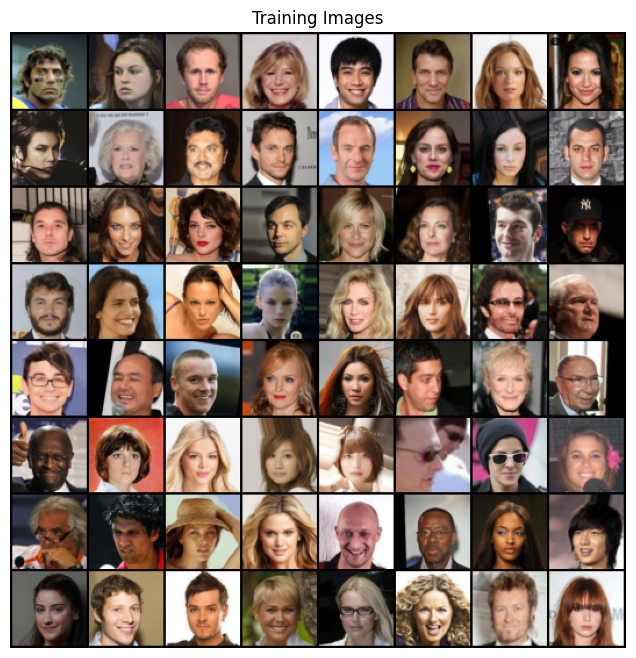

In [22]:
image_size = 64

dataset = dset.ImageFolder(
    root="dataset\CelebA",
    transform=transforms.Compose([
       transforms.Resize(image_size),
       transforms.CenterCrop(image_size),
       transforms.ToTensor(),
       transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=128, shuffle=True, num_workers=2)

real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()


In [29]:
class CSPup(nn.Module):
    def __init__(self, in_ch):
        super(CSPup, self).__init__()
        out_ch = in_ch // 2
        self.out_ch = out_ch
        self.right1 = nn.Sequential(
            nn.Conv2d(out_ch, out_ch, kernel_size=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(out_ch, out_ch, kernel_size=4, stride=2, padding=1)
        )
        self.right2 = nn.Sequential(
            nn.Conv2d(out_ch, out_ch, kernel_size=3, padding=1),
            nn.ReLU(True),
            nn.Conv2d(out_ch, out_ch, kernel_size=3, padding=1)
        )
        self.left = nn.ConvTranspose2d(out_ch, out_ch, kernel_size=4, stride=2, padding=1)
        

    def forward(self, x):
        x1, x2 = torch.split(x, self.out_ch, dim=1)
        left = self.left(x1)
        right = self.right2(self.right1(x2))
        return left + right

In [30]:
class Generator(nn.Module):
    def __init__(self, latent_dim, features_map_gen, num_channels):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, features_map_gen * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(features_map_gen * 8),
            nn.ReLU(True),
            CSPup(features_map_gen * 8),
            nn.BatchNorm2d(features_map_gen * 4),
            nn.ReLU(True),
            CSPup(features_map_gen * 4),
            nn.BatchNorm2d(features_map_gen * 2),
            nn.ReLU(True),
            CSPup(features_map_gen * 2),
            nn.BatchNorm2d(features_map_gen),
            nn.ReLU(True),
            nn.ConvTranspose2d(features_map_gen, num_channels, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)
    
class Discriminator(nn.Module):
    def __init__(self, num_channels, features_map_gen_dis, dropout=0.0):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(num_channels, features_map_gen_dis, 4, 2, 1, bias=False),
            nn.Dropout(dropout),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(features_map_gen_dis, features_map_gen_dis * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(features_map_gen_dis * 2),
            nn.Dropout(dropout),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(features_map_gen_dis * 2, features_map_gen_dis * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(features_map_gen_dis * 4),
            nn.Dropout(dropout),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(features_map_gen_dis * 4, features_map_gen_dis * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(features_map_gen_dis * 8),
            nn.Dropout(dropout),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(features_map_gen_dis * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [25]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

criterion = nn.BCELoss()

fixed_noise = torch.randn(64, 100, 1, 1, device=device)

real_label = 1.
fake_label = 0.

In [32]:
# Number of channels in the training images. For color images this is 3
num_channels = 3
# Size of z latent vector 
latent_dim = 100
# Size of feature maps in generator
features_map_gen = 64
# Size of feature maps in discriminator
features_map_dis = 64

lr_d = 0.0002
lr_g = 0.0002
beta1 = 0.5
dropout = 0
num_epochs = 10
unrolling_steps = 5

TASK_METADATA = DotDict(
    num_channels = num_channels,
    latent_dim = latent_dim,
    features_map_gen = features_map_gen,
    features_map_gen_dis = features_map_dis,
    lr_d = lr_d,
    lr_g = lr_g,
    beta1 = beta1,
    dropout = dropout,
    num_epochs = num_epochs,
    unrolling_steps = unrolling_steps
)

In [33]:
from clearml import Task, Logger

task = Task.init(
    project_name='gan_hw_2',
    task_name='train_gan'
)
cml_logger = cml_logger = Logger.current_logger()

Could not read Jupyter Notebook: No module named 'nbconvert'


ClearML Task: created new task id=a8f26a4676cc4d2ea7db8f386d3350f1
ClearML results page: https://app.clear.ml/projects/cc07a37895034fb59a687ff1406d1ef7/experiments/a8f26a4676cc4d2ea7db8f386d3350f1/output/log


In [34]:
GAN_G = Generator(latent_dim, features_map_gen, num_channels).to(device)
GAN_D = Discriminator(num_channels, features_map_dis, dropout).to(device)
GAN_G.apply(weights_init)
GAN_D.apply(weights_init)

optimizerD = optim.Adam(GAN_D.parameters(), lr=lr_d, betas=(beta1, 0.999))
optimizerG = optim.Adam(GAN_G.parameters(), lr=lr_g, betas=(beta1, 0.999))

img_list = []
G_losses = []
D_losses = []
iters = 0

In [36]:
for epoch in range(num_epochs):
    for i, data in enumerate(tqdm(dataloader), 0):
        GAN_D.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = GAN_D(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, latent_dim, 1, 1, device=device)
        fake = GAN_G(noise)
        label.fill_(fake_label)
        output = GAN_D(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        backup_params = [param.clone() for param in GAN_D.parameters()]
        for _ in range(unrolling_steps):
            GAN_D.zero_grad()
            output = GAN_D(fake.detach()).view(-1)
            errD_unrolled = criterion(output, label)
            errD_unrolled.backward()
            optimizerD.step()

        GAN_G.zero_grad()
        label.fill_(real_label)
        output = GAN_D(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        for param, backup_param in zip(GAN_D.parameters(), backup_params):
            param.data.copy_(backup_param)

        if i % 50 == 0:
            cml_logger.report_scalar("Loss", "D", iteration=iters, value=errD.item())
            cml_logger.report_scalar("Loss", "G", iteration=iters, value=errG.item())
            cml_logger.report_scalar("D(x)", "D(x)", iteration=iters, value=D_x)
            cml_logger.report_scalar("D(G(z))", "Before Update", iteration=iters, value=D_G_z1)
            cml_logger.report_scalar("D(G(z))", "After Update", iteration=iters, value=D_G_z2)

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = GAN_G(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
                # Сохраняем изображение
                img_filename = f"generated_images_{iters}.png"
                vutils.save_image(fake, img_filename, normalize=True)
                # Загружаем изображение как артефакт в ClearML
                task.upload_artifact(name=f"Generated Images at {iters}", artifact_object=img_filename)

        iters += 1

100%|██████████| 1583/1583 [03:37<00:00,  7.29it/s]


In [43]:
task.connect(TASK_METADATA)


{'num_channels': 3,
 'latent_dim': 100,
 'features_map_gen': 64,
 'features_map_gen_dis': 64,
 'lr_d': 0.0002,
 'lr_g': 0.0002,
 'beta1': 0.5,
 'dropout': 0,
 'num_epochs': 10,
 'unrolling_steps': 5}

In [ ]:
task.set_tags(['new-tag', 'another-tag'])

In [44]:
task.close()

In [37]:
torch.save(GAN_G.state_dict(), 'weights/GAN_G.pt')
torch.save(GAN_D.state_dict(), 'weights/GAN_D.pt')

Animation size has reached 21240236 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


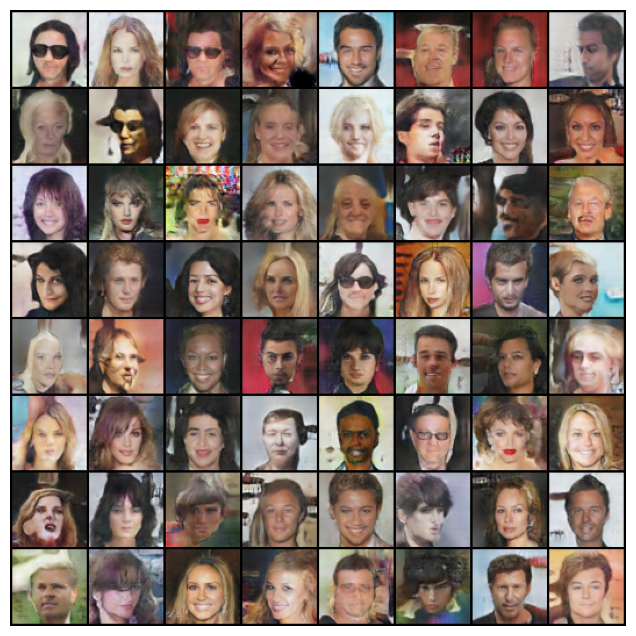

In [38]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())